In [72]:
import os, sys
import matplotlib.pyplot as plt
from random import randint

# set the path where the project is stored
local_path = '/Users/juniorcedrictonga/Documents/ML for times series/project/Online-Dictionary-Learning-for-Sparse-Coding'
sys.path.append(local_path)

%load_ext autoreload
%autoreload 2

from src import built_dataset, utils,inpainting_reconstruction,parameter_impact
import time
from sklearn.decomposition import MiniBatchDictionaryLearning
import numpy as np
import cv2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### Load the data

In [51]:
# path where data is stored
data_path='/Users/juniorcedrictonga/Documents/ML for times series/project/Online-Dictionary-Learning-for-Sparse-Coding/data'


train_data_path=data_path+'/seg_train/seg_train/'
test_data_path=data_path+'/seg_test/seg_test/'

# train set
train_image, train_label=built_dataset.get_images(train_data_path)
# test set
test_image, test_label=built_dataset.get_images(test_data_path)


  0%|          | 0/6 [00:00<?, ?it/s]

100%|██████████| 7/7 [00:01<00:00,  3.96it/s]


In [52]:
print('train image shape',train_image.shape)
print('test image shape',test_image.shape)

train image shape (14034, 150, 150, 3)
test image shape (3000, 150, 150, 3)


we will take 200 sample to train our dictionary and 100 for test. since computation power is limited

In [53]:
train_image,train_label=train_image[:200], train_label[:200]
test_image,test_label=test_image[:100], test_label[:100]

visualise our dataset

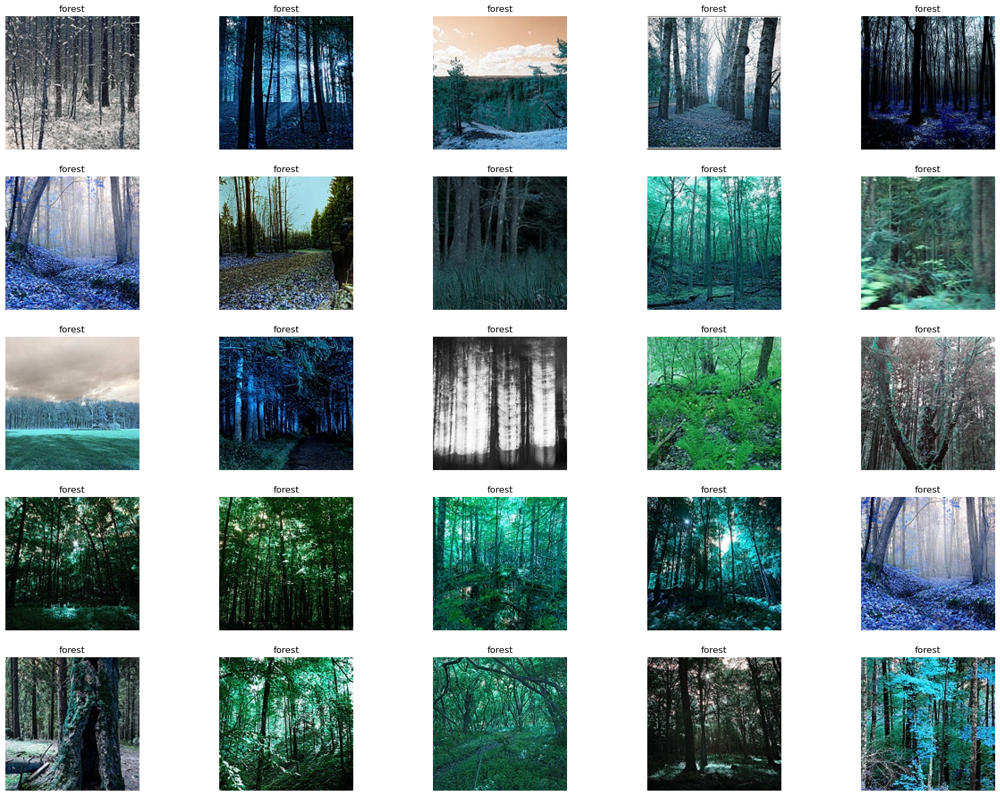

In [18]:
# train set
built_dataset.plot_image_and_image_with_text(train_image,train_label)

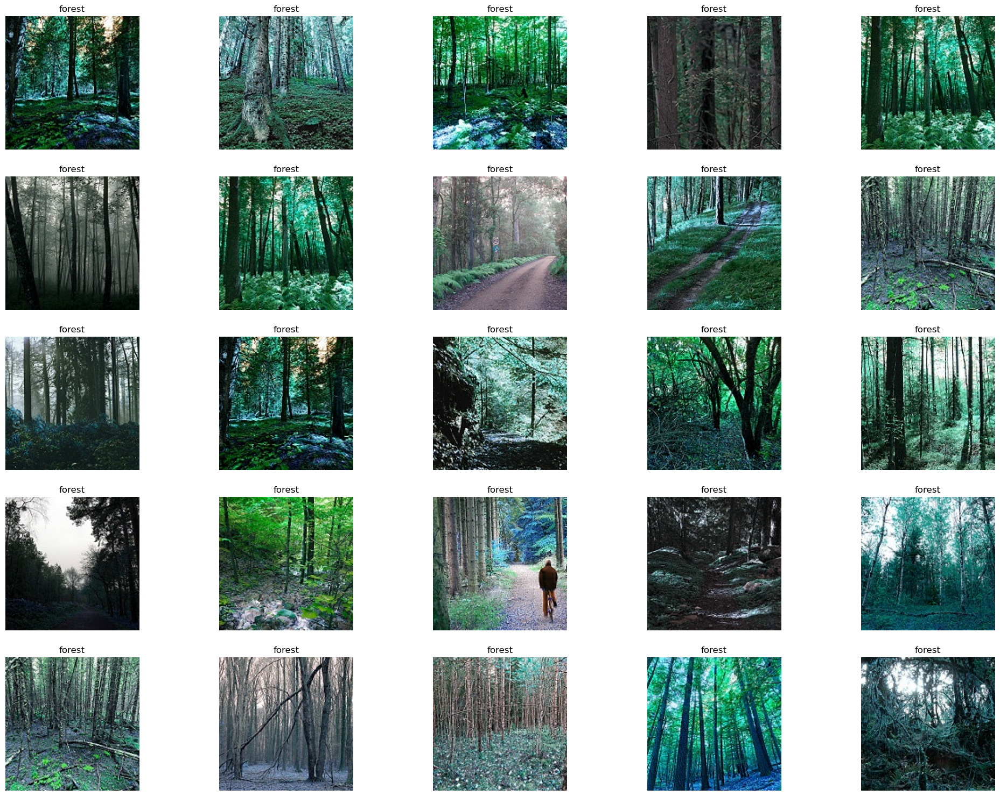

In [19]:
# test set
built_dataset.plot_image_and_image_with_text(test_image,test_label)

reshape the train and test set for the dictionary training 

In [54]:

train_image=train_image.reshape(train_image.shape[0], -1) 
train_image.shape

(200, 67500)

In [55]:
test_image=test_image.reshape(test_image.shape[0], -1)
test_image.shape

(100, 67500)

## 1. Sparse reconstruction and image impanting 

We trained a dictionary on the 200 images of the train set according to an increasing number of atoms. Then we used this dictionary 
- to reconstruct one or all of the test set images not seen during training. 
- By adding text to the test set images, we also tried to reconstruct them as original images without the text (image impanting).

In [24]:
# test for image inpainting
text = ['AST project','best course','we love it','MVA master']

- **4 atoms**

In [25]:
n_atoms = 4
dict_learner_4_atoms = MiniBatchDictionaryLearning(
    n_components=n_atoms, transform_algorithm='lasso_lars',
    random_state=42, verbose=True,
    batch_size=10,
).fit(train_image)

[dict_learning]
0 batches processed.
100 batches processed.
200 batches processed.
300 batches processed.
400 batches processed.
500 batches processed.
600 batches processed.
700 batches processed.
800 batches processed.
900 batches processed.


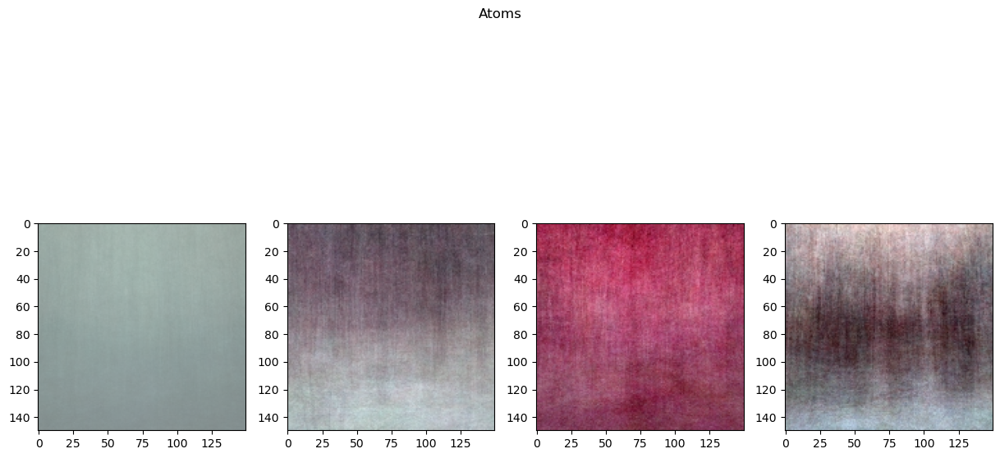

In [26]:
# take a look of atoms
utils.show_dictionary_atoms_img(dict_learner_4_atoms,color=True)

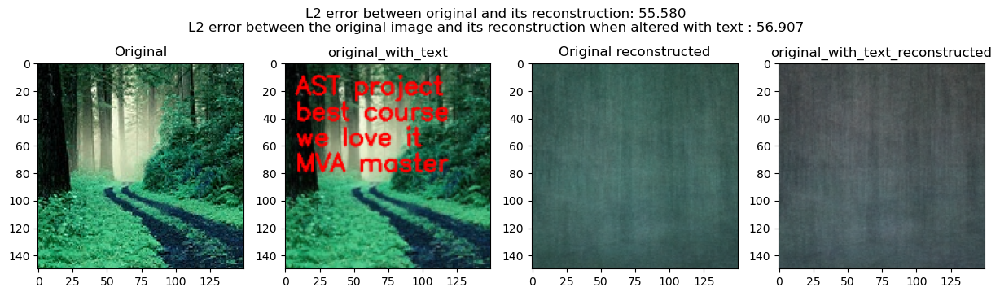

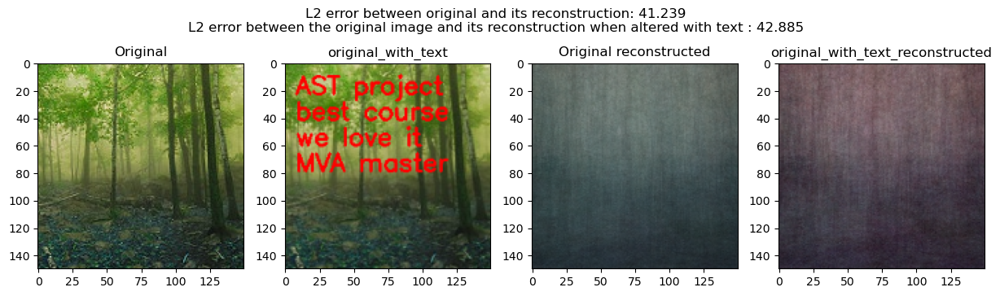

In [27]:
# plot reconstructions
for img_idx in [20,99]:
    img = np.reshape(test_image[img_idx], (150, 150,3))
    _, _, _ = inpainting_reconstruction.forge_and_reconstruct(img, dict_learner_4_atoms, text)

- **10 atoms**

In [28]:
n_atoms = 10
dict_learner_10_atoms = MiniBatchDictionaryLearning(
    n_components=n_atoms, transform_algorithm='lasso_lars',
    random_state=42, verbose=True,
    batch_size=10,
).fit(train_image)

[dict_learning]
0 batches processed.
100 batches processed.
200 batches processed.
300 batches processed.
400 batches processed.
500 batches processed.
600 batches processed.
700 batches processed.
800 batches processed.
900 batches processed.


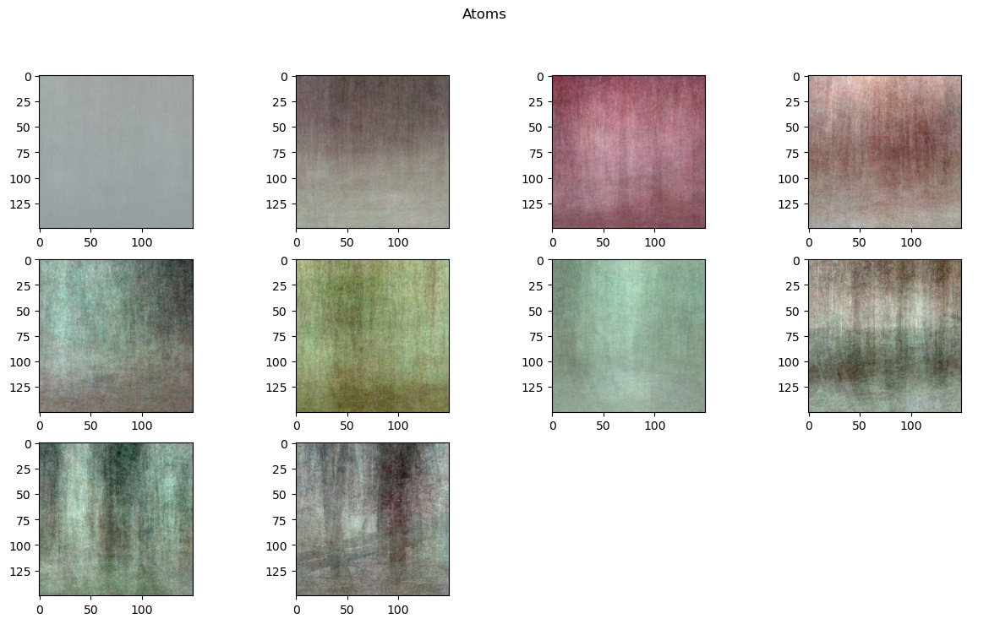

In [29]:
utils.show_dictionary_atoms_img(dict_learner_10_atoms,color=True)

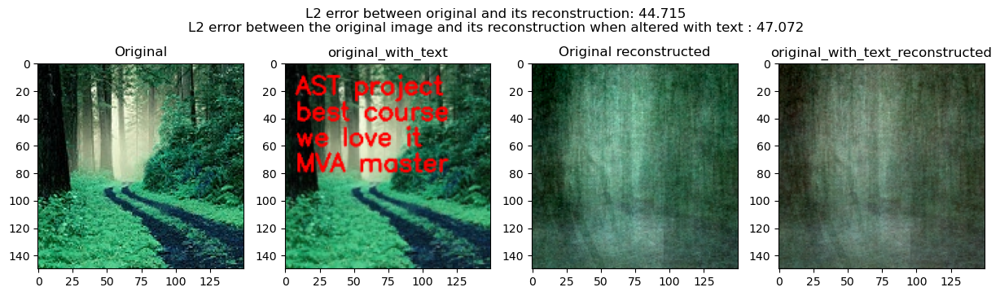

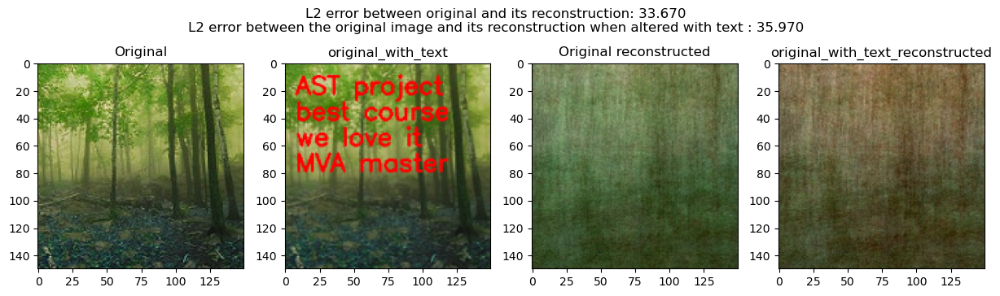

In [30]:
for img_idx in [20,99]:
    img = np.reshape(test_image[img_idx], (150, 150,3))
    _, _, _ = inpainting_reconstruction.forge_and_reconstruct(img, dict_learner_10_atoms, text)

- **20 atoms**


In [31]:
n_atoms = 20
dict_learner_20_atoms = MiniBatchDictionaryLearning(
    n_components=n_atoms, transform_algorithm='lasso_lars',
    random_state=42, verbose=True,
    batch_size=10,
).fit(train_image)

[dict_learning]
0 batches processed.
100 batches processed.
200 batches processed.
300 batches processed.
400 batches processed.
500 batches processed.
600 batches processed.
700 batches processed.
800 batches processed.
900 batches processed.


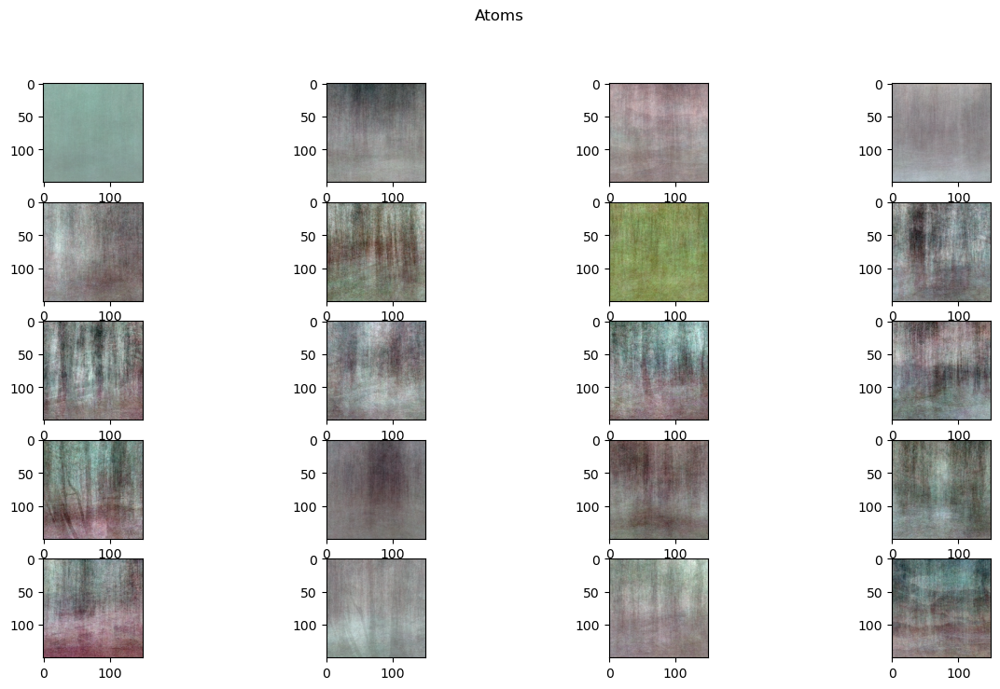

In [99]:
utils.show_dictionary_atoms_img(dict_learner_20_atoms,color=True)

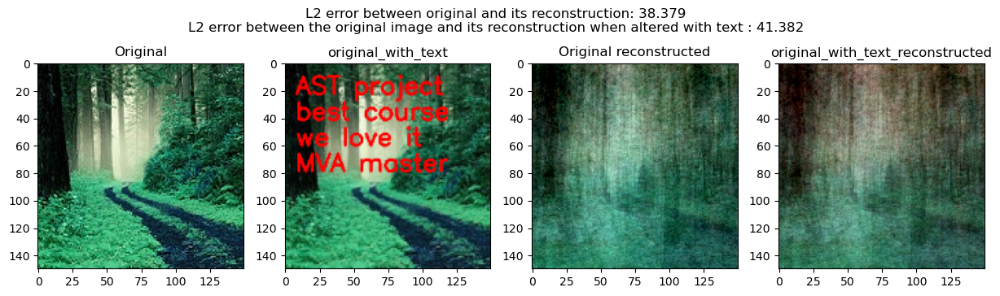

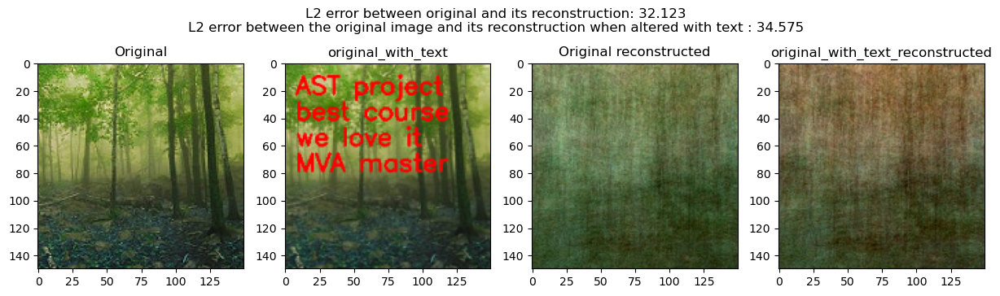

In [32]:
for img_idx in [20,99]:
    img = np.reshape(test_image[img_idx], (150, 150,3))
    _, _, _ = inpainting_reconstruction.forge_and_reconstruct(img, dict_learner_20_atoms, text)

- **50 atoms**

In [33]:
n_atoms = 50
dict_learner_50_atoms = MiniBatchDictionaryLearning(
    n_components=n_atoms, transform_algorithm='lasso_lars',
    random_state=42, verbose=True,
    batch_size=10,
).fit(train_image)

[dict_learning]
0 batches processed.
100 batches processed.
200 batches processed.
300 batches processed.
400 batches processed.
500 batches processed.
600 batches processed.
700 batches processed.
800 batches processed.
900 batches processed.


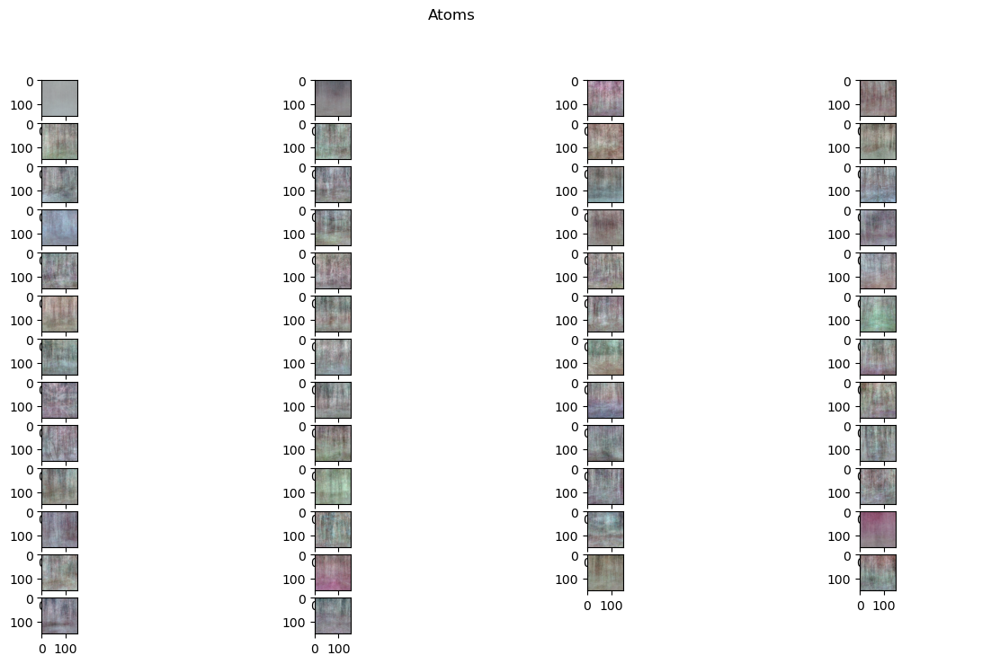

In [34]:
utils.show_dictionary_atoms_img(dict_learner_50_atoms,color=True)

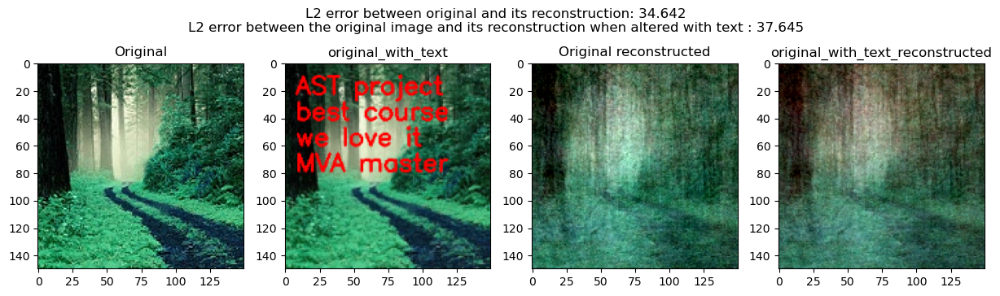

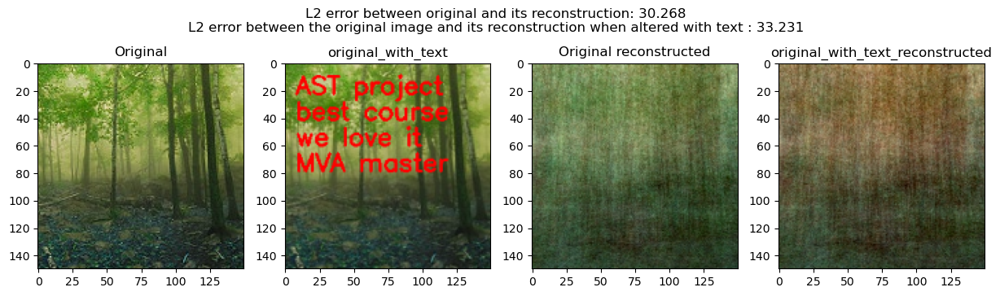

In [35]:
for img_idx in [20,99]:
    img = np.reshape(test_image[img_idx], (150, 150,3))
    _, _, _ = inpainting_reconstruction.forge_and_reconstruct(img, dict_learner_50_atoms, text)

- **100 atoms**

In [36]:
n_atoms = 100
dict_learner_100_atoms = MiniBatchDictionaryLearning(
    n_components=n_atoms, transform_algorithm='lasso_lars',
    random_state=42, verbose=True,
    batch_size=10,
).fit(train_image)

[dict_learning]
0 batches processed.
100 batches processed.
200 batches processed.
300 batches processed.
400 batches processed.
500 batches processed.
600 batches processed.
700 batches processed.
800 batches processed.
900 batches processed.


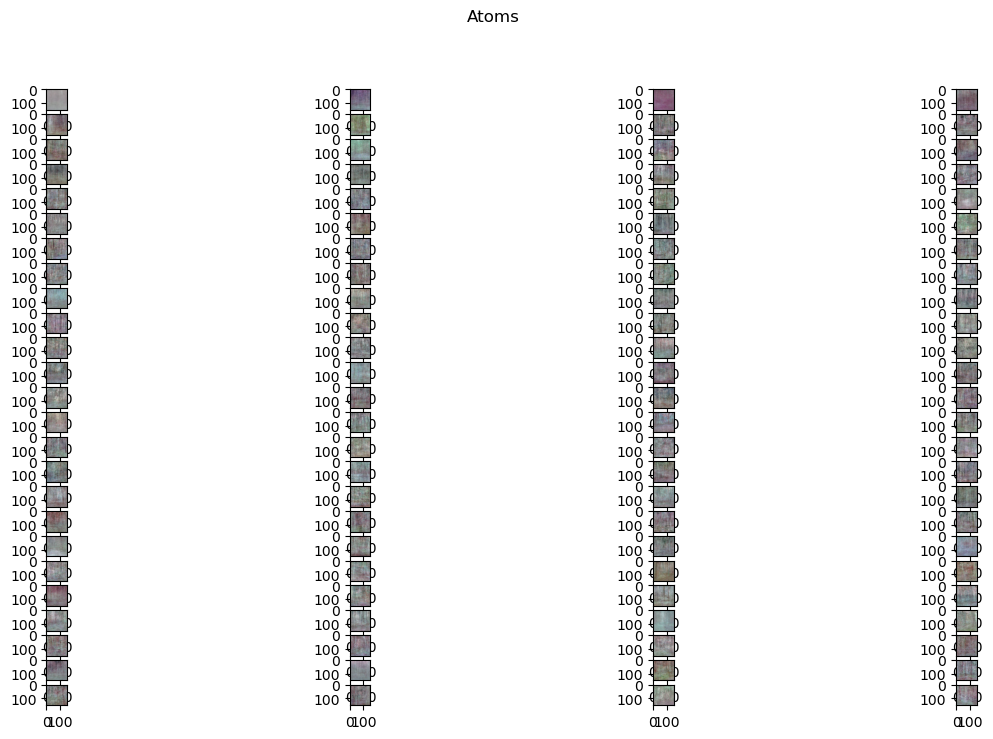

In [37]:
utils.show_dictionary_atoms_img(dict_learner_100_atoms,color=True)

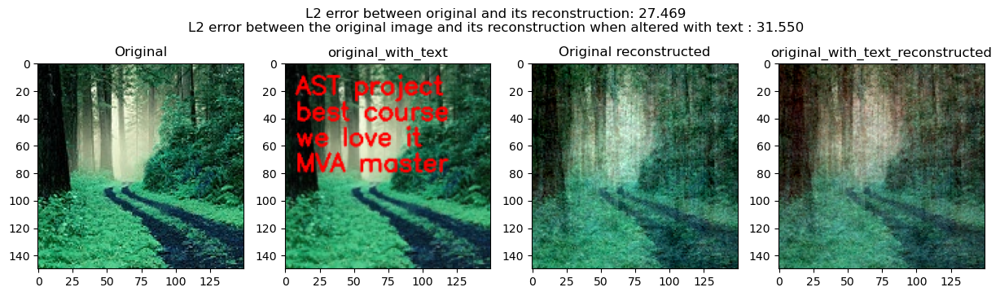

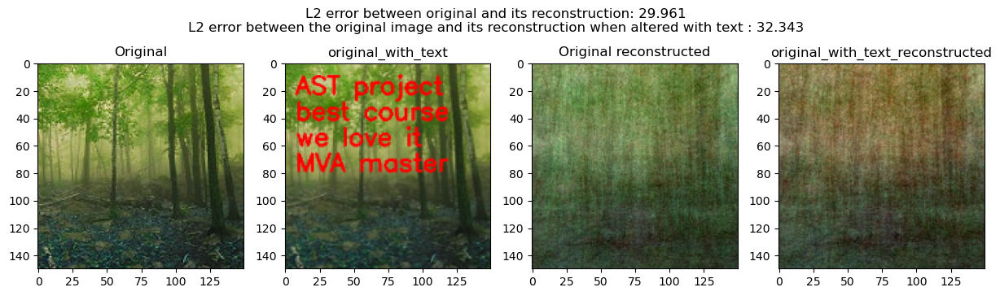

In [38]:
for img_idx in [20,99]:
    img = np.reshape(test_image[img_idx], (150, 150,3))
    _, _, _ = inpainting_reconstruction.forge_and_reconstruct(img, dict_learner_100_atoms, text)

- **300 atoms**

In [39]:
n_atoms = 300
dict_learner_300_atoms_10B = MiniBatchDictionaryLearning(
    n_components=n_atoms, transform_algorithm='lasso_lars',
    random_state=42, verbose=True,
    batch_size=10,
).fit(train_image)

[dict_learning]
100 unused atoms resampled.
0 batches processed.
99 unused atoms resampled.
83 unused atoms resampled.


/Users/juniorcedrictonga/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_least_angle.py:678: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 40 iterations, alpha=5.891e-05, previous alpha=5.891e-05, with an active set of 27 regressors.
  warnings.warn(


63 unused atoms resampled.
45 unused atoms resampled.
32 unused atoms resampled.
20 unused atoms resampled.
9 unused atoms resampled.
2 unused atoms resampled.
100 batches processed.
200 batches processed.
300 batches processed.
400 batches processed.
500 batches processed.
600 batches processed.
700 batches processed.
800 batches processed.
900 batches processed.


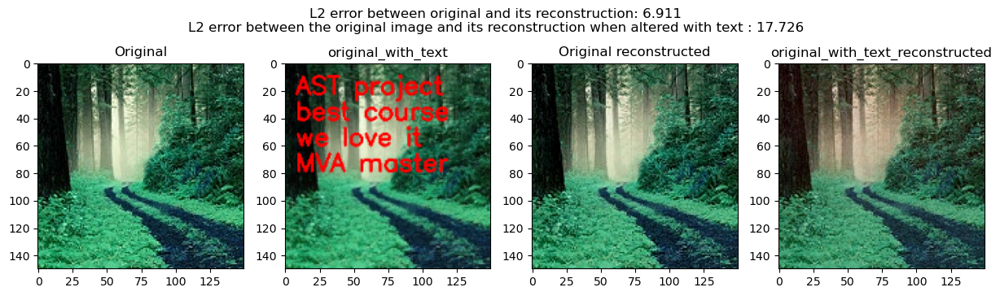

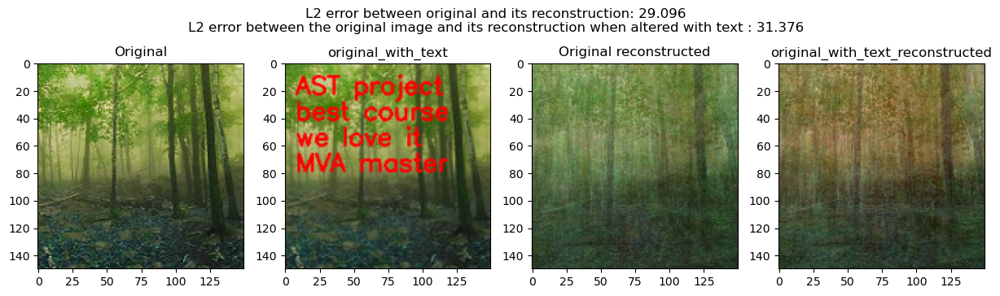

In [76]:
for img_idx in [20,99]:
    img = np.reshape(test_image[img_idx], (150, 150,3))
    _, _, _ = inpainting_reconstruction.forge_and_reconstruct(img, dict_learner_300_atoms_10B, text)

### **Comment**

We observe that when the number of atoms is less than 50, the reconstruction is not good, which could be explained by the fact that the number of atoms is not sufficient to be able to reconstruct efficiently. When the number of atoms is increased to 100, the reconstruction becomes better for these images. But this is not the case for all the images in the test set. 

In addition, we note that as the number of atoms increases, the reconstruction error also decreases, suggesting that learning is taking place efficiently.

### 2. What happens if we blur the image? will the learned dictionary still be able to reconstruct the original without this disturbance? will it be robust?

In [67]:
def add_artifacts(image):
    # add blur
    modified_image = cv2.medianBlur(image,5)
    return modified_image

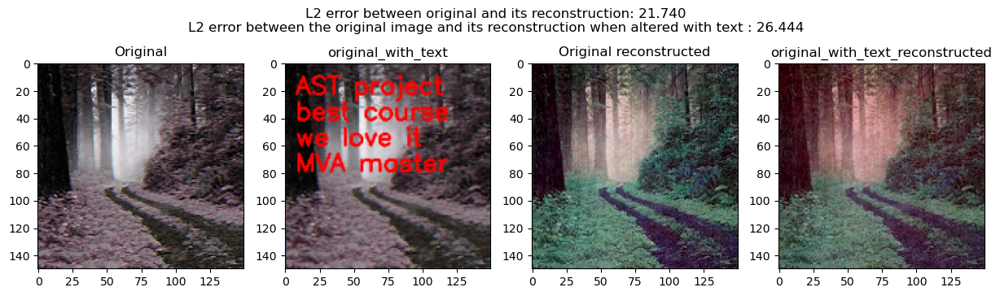

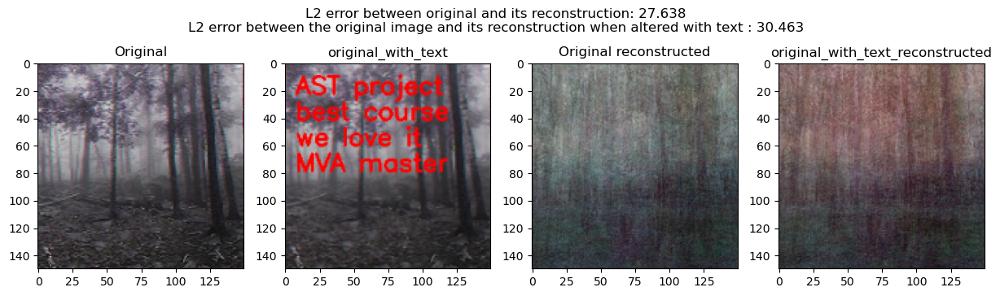

In [68]:
for img_idx in [20,99]:
    # add blur 
    t=add_artifacts(test_image[img_idx])
    img = np.reshape(t, (150, 150,3))
    # reconstruct
    _, _, _ = inpainting_reconstruction.forge_and_reconstruct(img, dict_learner_300_atoms_10B, text)

### **Comment**

We tried to see if the learned dictionary was robust to certain changes. To check this, we repeated the previous experiment, but this time with blurring as well. We observed that the dictionary still reconstructed the images, even though the errors increased. We could say that the dictionary really did capture the essential elements of the learning process, and not just the noise.

### 3. Impact of parameter on dictionary learning

- number atoms


 10%|█         | 2/20 [00:02<00:22,  1.26s/it]/Users/juniorcedrictonga/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_least_angle.py:648: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 52 iterations, i.e. alpha=9.268e-06, with an active set of 16 regressors, and the smallest cholesky pivot element being 2.220e-16. Reduce max_iter or increase eps parameters.
  warnings.warn(
 15%|█▌        | 3/20 [00:03<00:23,  1.37s/it]/Users/juniorcedrictonga/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_least_angle.py:678: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 55 iterations, alpha=1.445e-05, previous alpha=1.437e-05, with an active set of 22 regressors.
  warnings.warn(
 20%|██        | 4/20 [00:05<00:22,  1.39s/it]/Users/juniorcedrictonga/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_least_angle.py:678: ConvergenceWarning

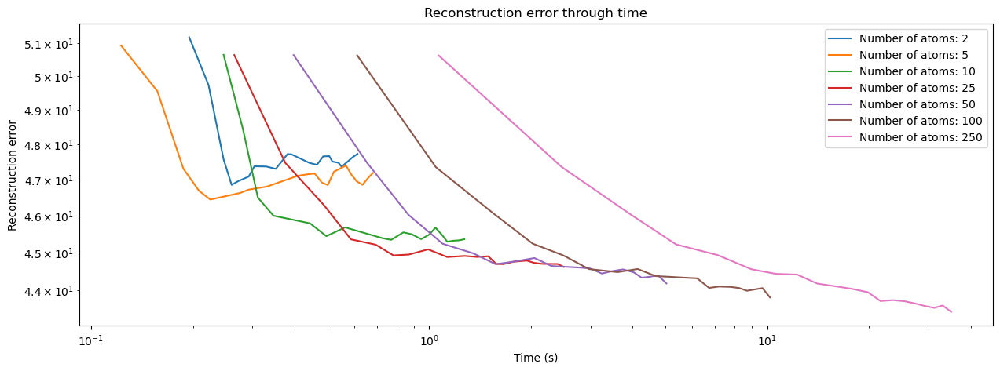

In [96]:
list_n_atoms = [2, 5, 10, 25, 50, 100, 250]
list_batch_sizes = [10]
list_alpha= [0.5]

test_img=test_image[0][np.newaxis, :]

parameter_impact.eval_impact_parameters_on_reconstruction(train_image, test_img, list_n_atoms, list_batch_sizes, list_alpha,label_name="Number of atoms:", label_values=list_n_atoms)

- batch size

67it [00:04, 15.14it/s]                        
100%|██████████| 2/2 [00:00<00:00,  2.08it/s]
/Users/juniorcedrictonga/Documents/ML for times series/project/Online-Dictionary-Learning-for-Sparse-Coding/src/parameter_impact.py:66: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  
/Users/juniorcedrictonga/Documents/ML for times series/project/Online-Dictionary-Learning-for-Sparse-Coding/src/parameter_impact.py:67: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  reconstruction_errors = np.array(reconstruction_errors)


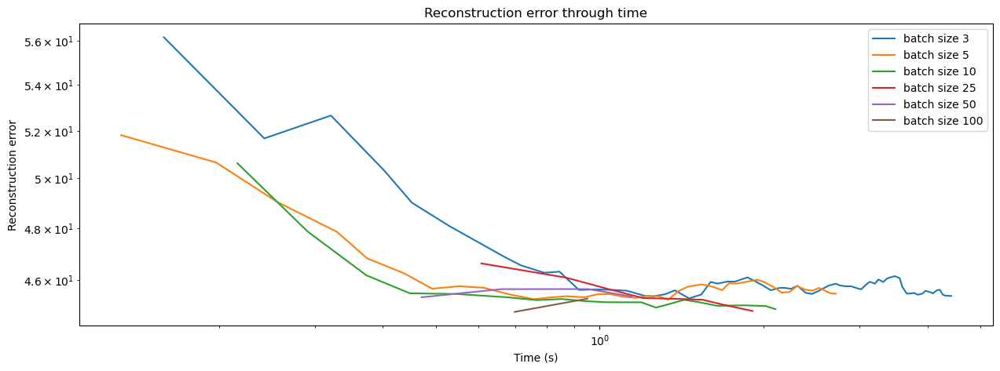

In [97]:
list_n_atoms = [20]
list_batch_sizes = [3, 5, 10, 25, 50, 100]
list_alpha= [0.5]

parameter_impact.eval_impact_parameters_on_reconstruction(train_image, test_img, list_n_atoms, list_batch_sizes, list_alpha,label_name="batch size", label_values=list_batch_sizes)

- sparsity parameter $\alpha$

  0%|          | 0/40 [00:00<?, ?it/s]

 10%|█         | 4/40 [00:00<00:04,  8.52it/s]/Users/juniorcedrictonga/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_least_angle.py:678: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 42 iterations, alpha=2.046e-07, previous alpha=2.037e-07, with an active set of 19 regressors.
  warnings.warn(
100%|██████████| 40/40 [00:02<00:00, 15.19it/s]


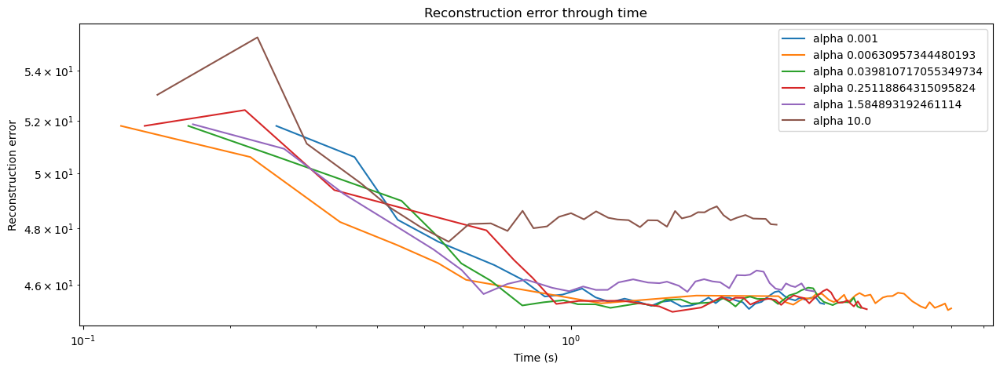

In [98]:
list_n_atoms = [20]
list_batch_sizes = [5]
list_alpha = np.logspace(-3, 1, 6)
parameter_impact.eval_impact_parameters_on_reconstruction(train_image, test_img, list_n_atoms, list_batch_sizes, list_alpha,label_name="alpha", label_values=list_alpha)

### **Comment**

Some observations : 
- Increasing the number of atoms leads to more accurate reconstruction, but the atoms converge slowly, primarily due to noise in the dictionary.
- A larger batch size accelerates the convergence of the dictionary.
- Higher penalization results in faster computation, as representations become more sparse. However, with large penalizations, the convergence of dictionaries becomes very slow.